# 사용 패키지

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import lightgbm as lgb
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')
plt.rc('font', family='Malgun Gothic') 

# 데이터 로드

In [2]:
total = pd.read_csv('./data/한국가스공사_시간별 공급량_20181231.csv', encoding='cp949')

In [3]:
total.head()

,연월일,시간,구분,공급량
0,2013-01-01,1,A,2497.129
1,2013-01-01,2,A,2363.265
2,2013-01-01,3,A,2258.505
3,2013-01-01,4,A,2243.969
4,2013-01-01,5,A,2344.105


# 전처리

In [4]:
supplys = total['구분'].unique() # 뒤부분에서 공급사 별로 사용하기 위해 미리 공급사의 리스트 생성
supplys

array(['A', 'B', 'C', 'D', 'E', 'G', 'H'], dtype=object)

In [5]:
total['연월일'] = pd.to_datetime(total['연월일']) #시계열 분석을 위한 datetime화

In [6]:
# 시계열 분석을 위해 나눠서 컬럼들 생성
total['year'] = total['연월일'].dt.year
total['month'] = total['연월일'].dt.month
total['day'] = total['연월일'].dt.day
total['weekday'] = total['연월일'].dt.weekday

In [7]:
# 한글 컬럼들을 영어로 rename
total.rename(columns={'연월일':'datetime',
             '시간':'hour',
             '구분':'supplys',
             '공급량':'target'}, inplace=True)

In [8]:
# 2016년에만 2월 29일이 존재하여 예측년도 2019년 포함 다른년도에는 존재하지않아 빼주도록하겠습니다.
total = total[total['datetime'] != '2016-2-29']

# 기온데이터 병합

In [9]:
temp_data = pd.read_csv("data/2013_2019_날씨데이터.csv", encoding='cp949' )[7:] # 유의한 데이터 row부터 추출
temp_data.rename(columns={"기온분석":"datetime", "Unnamed: 1":"region", "Unnamed: 2":"avg_temp", "Unnamed: 3":"mini_temp","Unnamed: 4":"max_temp"} , inplace=True) # 컬럼 이름맞게 재설정
temp_data['datetime'] = pd.to_datetime(temp_data['datetime']) # merge를 위해 total 컬럼과 같은 형태로 바꿈
total = pd.merge(total, temp_data, on='datetime', how='left') # 시간을 제외한 하루하루에대한 온도를 병합
total[['avg_temp','mini_temp','max_temp']] = total[['avg_temp','mini_temp','max_temp']].astype(float) # max,min,avg temp (object) ---> float
total=total[['supplys','year','month','day','weekday','hour','datetime','avg_temp','mini_temp','max_temp','target']] #매끄럽게 보기위해 컬럼 순서 설정 및 region 컬럼 drop
total

,supplys,year,month,day,weekday,hour,datetime,avg_temp,mini_temp,max_temp,target
0,A,2013,1,1,1,1,2013-01-01,-3.2,-9.1,2.6,2497.129
1,A,2013,1,1,1,2,2013-01-01,-3.2,-9.1,2.6,2363.265
2,A,2013,1,1,1,3,2013-01-01,-3.2,-9.1,2.6,2258.505
3,A,2013,1,1,1,4,2013-01-01,-3.2,-9.1,2.6,2243.969
4,A,2013,1,1,1,5,2013-01-01,-3.2,-9.1,2.6,2344.105
...,...,...,...,...,...,...,...,...,...,...,...
367915,H,2018,12,31,0,20,2018-12-31,-3.2,-9.9,4.0,681.033
367916,H,2018,12,31,0,21,2018-12-31,-3.2,-9.9,4.0,669.961
367917,H,2018,12,31,0,22,2018-12-31,-3.2,-9.9,4.0,657.941
367918,H,2018,12,31,0,23,2018-12-31,-3.2,-9.9,4.0,610.953


In [10]:
# supplys 빼고는 전부 int or float 확인
total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 367920 entries, 0 to 367919
Data columns (total 11 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   supplys    367920 non-null  object        
 1   year       367920 non-null  int64         
 2   month      367920 non-null  int64         
 3   day        367920 non-null  int64         
 4   weekday    367920 non-null  int64         
 5   hour       367920 non-null  int64         
 6   datetime   367920 non-null  datetime64[ns]
 7   avg_temp   367920 non-null  float64       
 8   mini_temp  367920 non-null  float64       
 9   max_temp   367920 non-null  float64       
 10  target     367920 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(5), object(1)
memory usage: 33.7+ MB


---------------------

# 전처리(분석)

회사 규모별 공급량 크기가 각기 다르다.  
#### <계절>-사용량 상대적  
4 ~ 10 월 : 사용량 적음.  
3월, 11월 : 사용량 보통.  
12월,1월,2월 : 사용량 많음.  
#### <시간대>-사용량 상대적  
02시 ~ 04시 : 사용량 적음.  
05시 ~ 07시 : 사용량 보통.  
08시 ~ 12시 : 사용량 많음.  
13시 ~ 18시 : 사용량 보통.  
19시 ~ 25시 : 사용량 많음.  

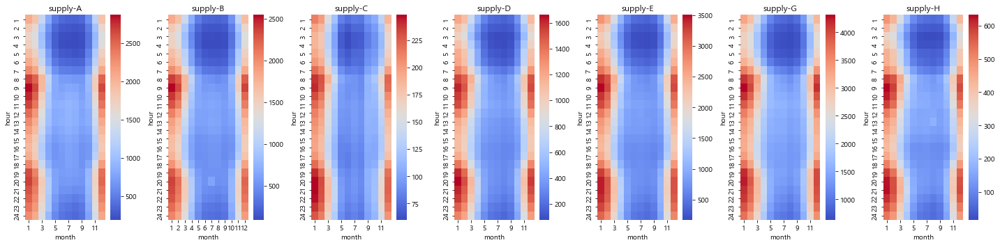

In [11]:
#각기 년도마다의 기온차이도 중요,하지만 일단 여기서는 계절, 밤낮 기온으로 가스량 초점을 두고 분석

fig = plt.figure(figsize = (20, 5))

for num,supply in enumerate(supplys):
    df_supply = total[total['supplys'] == supply]
    df_supply_year_month = df_supply.groupby(['month','hour'])[['target']].mean().reset_index()
    df_supply_year_month = df_supply_year_month.pivot('hour','month','target')
    plt.subplot(1,7, num+1)
    plt.title(f'supply-{supply}')
    sns.heatmap(df_supply_year_month, cbar=True, cmap='coolwarm')
    fig.tight_layout()


### 그래프에 이어 수치로도 확인

In [11]:
# target이 max와 min일때의 시간대 비율을 알기 위해 각 값들을 list 구합니다.
years_list = [2013,2014,2015,2016,2017,2018]
month_list = [1,2,3,4,5,6,7,8,9,10,11,12]
target_max_time = []
target_min_time = []


for supply in tqdm(supplys): # 공급사별
    supply_df = total[total['supplys'] == supply]
    for year in years_list: # 연도별
        supply_year_df = supply_df[supply_df['year'] == year]
        for month in month_list: # 달별
            supply_year_month_df = supply_year_df[supply_year_df['month'] == month]
            for day in supply_year_month_df['day'].unique(): # 일별
                supply_year_month_day_df = supply_year_month_df[supply_year_month_df['day'] == day]
                supply_year_month_day_target_max = supply_year_month_day_df[supply_year_month_day_df['target'] == supply_year_month_day_df['target'].max()]
                target_max_time.append(supply_year_month_day_target_max['hour'].values)
                supply_year_month_day_target_min = supply_year_month_day_df[supply_year_month_day_df['target'] == supply_year_month_day_df['target'].min()]
                target_min_time.append(supply_year_month_day_target_min['hour'].values)

  0%|          | 0/7 [00:01<?, ?it/s]


KeyboardInterrupt: 

<AxesSubplot:xlabel='0'>

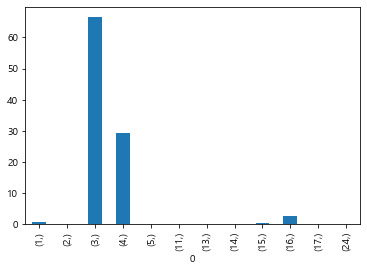

In [368]:
# target이 min일때 시간들의 비율
# 새벽 3, 4 시가 96% 정도로 거의 3, 4시일때 target 최저
# 오후 15, 16 시도 3% 정도로 차지 (최고기온일때)
# (가정) target
target_min_time_df = pd.DataFrame(data = target_min_time , index=[ i for i in range(len(target_min_time))])
target_min_time_df = target_min_time_df.iloc[: , [0]]
min_vc = target_min_time_df.value_counts()
min_cv_percent = min_vc/min_vc.sum() * 100
np.round(min_cv_percent.sort_index(),1).plot(kind='bar')

<AxesSubplot:xlabel='0'>

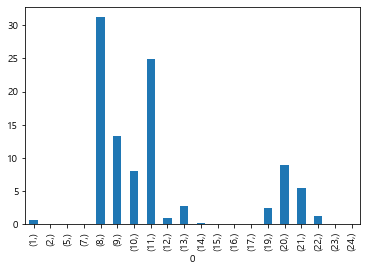

In [369]:
# target이 max일때 시간들의 비율
# min값들과는 달리 8,9,10,11 하루 일과가 시작하는 시간대에 약 77.4%
# 또한 퇴근후 집에서 난방을 위해 19,20,21,22시간대에 약 18%
# 출근 후, 퇴근 후 난방 사용 총 95.4 %
target_max_time_df = pd.DataFrame(data = target_max_time , index=[ i for i in range(len(target_max_time))])
target_max_time_df = target_max_time_df.iloc[: , [0]]
max_vc = target_max_time_df.value_counts()
max_vc_percent = max_vc/max_vc.sum() * 100
np.round(max_vc_percent.sort_index(),1).plot(kind='bar')

# 전처리(outlier 처리)

100%|██████████| 7/7 [00:21<00:00,  3.10s/it]


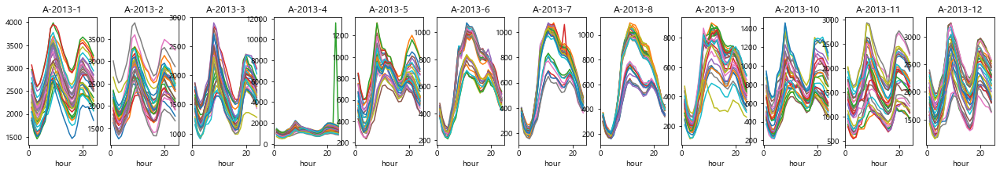

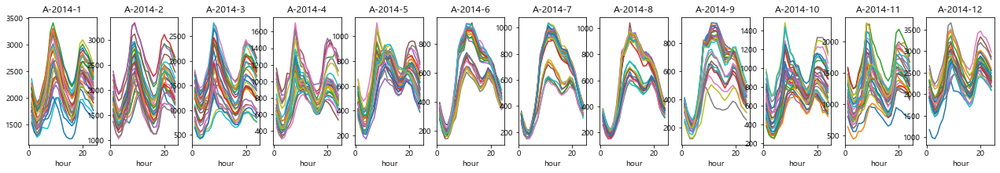

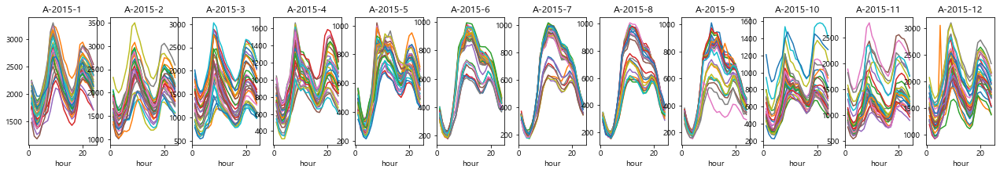

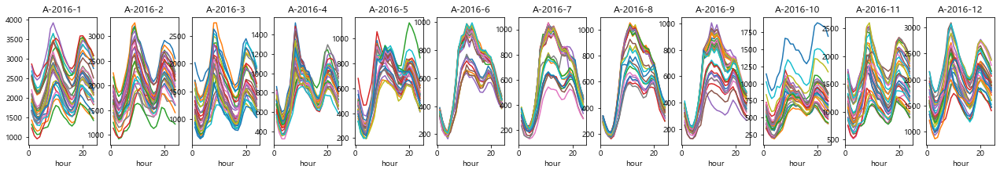

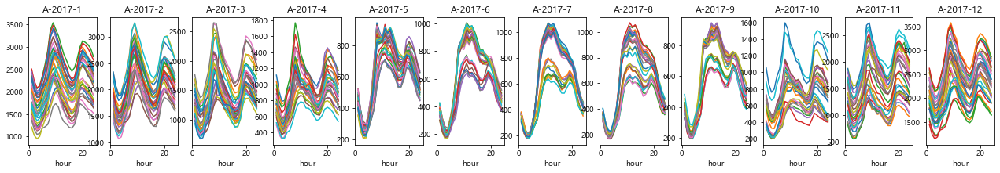

...

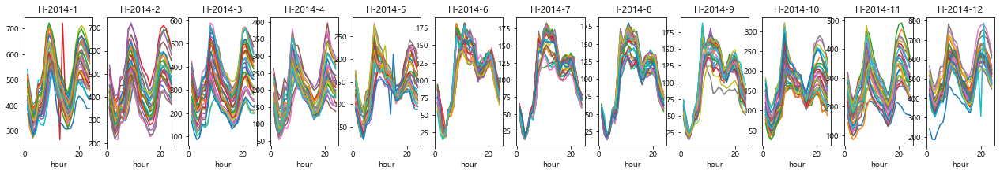

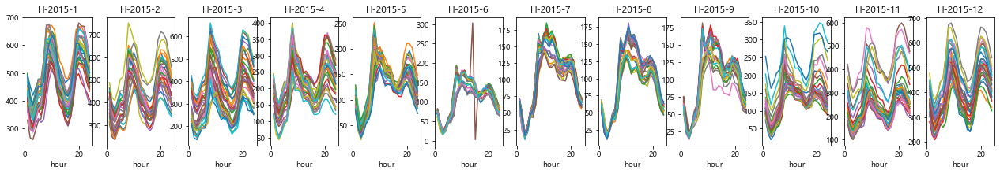

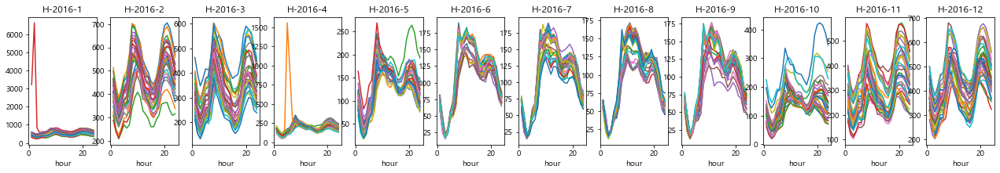

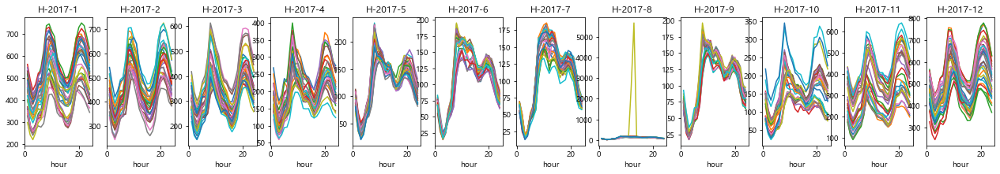

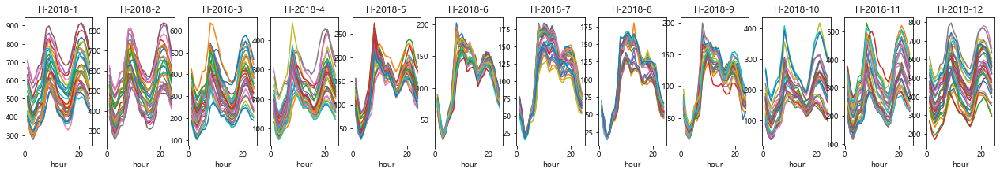

In [9]:
# 공급사-년도별-달별-각일별의 시간대 그래프 -> 이상치 잡기
years_list = [2013,2014,2015,2016,2017,2018]
month_list = [1,2,3,4,5,6,7,8,9,10,11,12]
# total['sqrt_target'] = np.sqrt(total['target'])


for supply in tqdm(supplys):
    supply_df = total[total['supplys'] == supply]
    for year in years_list:
        supply_year_df = supply_df[supply_df['year'] == year]
        plt.figure(figsize=(22,3))
        for month in month_list: 
            supply_year_month_df = supply_year_df[supply_year_df['month'] == month]
            plt.subplot(1,12,month)
            plt.title(f'{supply}-{year}-{month}')
            plt.xlabel('hour')
#             plt.ylim(0, 5500)
            
            for day in supply_year_month_df['day'].unique():
                supply_year_month_day_df = supply_year_month_df[supply_year_month_df['day'] == day]
                plt.plot(supply_year_month_day_df['hour'],supply_year_month_day_df['target'], label=f'{day}')
            

In [34]:
# 이상치 탐색의 생산성을 높여주기위해 DataFrame을 얻을수 있는 함수 생성
def create_df(supply, year, month):
    
    df = total[total['supplys'] == supply]
    df = df[df['year'] == year]
    df = df[df['month'] == month]
    
    return df

In [35]:
# 이상치 탐색의 생산성을 높여주기위해 plot 얻을수 있는 함수 생성
def create_plot(supply, year, month,day):
    df = total[total['supplys'] == supply]
    df = df[df['year'] == year]
    df = df[df['month'] == month]
    plot = df[df['day'] == day]['target'].plot()
    return plot

## 위의 그래프에서 target값이 0의 근처 밑으로 가는 이상치들 기준 잡기위해 데이터 탐색 및 처리 (supplys - C, H)
* C사의 이상치는 1.378, 2.756로 관측되어 집니다.(년도마다 한달정도씩 결측치값을 보유하는것을 볼수있습니다.)
* C사 2013년 8월 12일 ~ 9월 2일 (1.378)
* C사 2014년 4월 21일 ~ 5월 8일 (1.378)
* C사 2014년 12월 9일 ~ 12월 11일 (1.378)
* C사 2015년 5월 12일 ~ 5월 28일 (1.378)
* C사 2016년 5월 9일 ~ 5월 23일 (1.378)
* C사 2016년 8월 11일 ~ 8월 12일 (1.378)
* C사 2017년 6월 15일 ~ 6월 30일 (1.378)
* C사 2018년 6월 20일 ~ 7월 23일 결측치 (2.756)


In [36]:
C = total[total['supplys'] == 'C']

print(C['target'].sort_values().value_counts())
# print(C[C['target'] == 2.756]['datetime'].unique())
# print(C[C['t|arget'] == 1.378]['datetime'].unique())
C.quantile(0.1)

1.378      1954
2.756       793
98.178      409
101.378     391
100.578     387
           ... 
159.861       1
159.863       1
159.872       1
159.942       1
358.654       1
Name: target, Length: 5075, dtype: int64


year         2013.00
month           2.00
day             4.00
weekday         0.00
hour            3.00
avg_temp       -0.10
mini_temp      -4.90
max_temp        4.80
target         75.43
Name: 0.1, dtype: float64

In [37]:
print(supplys)
print(years_list)
print(month_list)

['A' 'B' 'C' 'D' 'E' 'G' 'H']
[2013, 2014, 2015, 2016, 2017, 2018]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]


In [38]:
# nan값으로 바꿀 index 저장
nan_index_list = []

for month in month_list:
    C_month = C[C['month'] == month]
    
    hour_list = list(range(1, 25, 1))
    
    # 같은 month, 같은 시간대의 IQR범위 구하기 위해서이다.
    for hour in hour_list:
        C_hour = C_month[C_month['hour'] == hour]
        Q1 = C_hour['target'].quantile(0.25)
        Q3 = C_hour['target'].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5*IQR
        
        # 값이 lower_bound이상치보다 작으면서 99미만이거나, 1.378, 2.756 중 하나이면 무조건 넣어버린다
        condition = C_hour[(C_hour['target'] < lower_bound) & (C_hour['target'] < 100) | (C_hour['target'].isin([1.378, 2.756])) ]
        nan_index_list += condition.index.tolist()

print(len(nan_index_list))

2822


In [45]:
C.loc[nan_index_list, 'target'] = np.nan

In [50]:
# nan이 하나라도 들어 있는 날은 regression 예측 대상이기 때문에 다 모아준다
nan_list = C[C['target'].isna()]['datetime'].unique()
print(len(nan_list))

138


In [51]:
C.isna().sum()

supplys         0
year            0
month           0
day             0
weekday         0
hour            0
datetime        0
avg_temp        0
mini_temp       0
max_temp        0
target       2822
dtype: int64

In [52]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures

In [53]:
index_list = []
predict_list = []

# 예측 대상을 제외한 모든 연도의 같은 날을 대상으로 훈련시킨다
# ex) 2016.07.01을 예측해야 한다면 16년을 제외한 13, 14, 15, 17, 18년 7월 1일을 대상으로 훈련 (훈련 데이터 개수 : 5 * 24 = 120개)
for i in range(len(nan_list)):
    
    # nan값을 채울 날을 지정해준다.
    nan_datetime = nan_list[i]
    pred_required = C.loc[(C['target'].isna() == True) & (C['datetime'] == nan_datetime)]
    
    
    # 훈련 대상 만듦
    # 동일 연도가 아니면서(pred_required가 2014년 x월 x일이면 2014년을 제외한 모든 동일 month, day의 값들을 train 대상)    
    year, month, day = pred_required[['year', 'month', 'day']].iloc[0]
    condition = (C['year'] != year) & (C['month'] == month) & (C['day'] == day)    
    
    # 조건에 부합하면서, nan값이 속하지 않아야함.(모델 돌릴때 오류 생기기 때문)
    c_df = C.loc[condition, :].copy().dropna(axis=0)
    
    #모델 생성
    lin_reg = LinearRegression()
    
    # 시간과 target의 관계는 5차함수
    X = c_df[['hour']]
    y = c_df[['target']]
    
    # X의 변수들을 5차함수 꼴로 변환
    poly = PolynomialFeatures(degree=5, include_bias=True)
    X_poly = poly.fit_transform(X)

    
    # 모델 훈련
    X_train, X_test, y_train, y_test = train_test_split(X_poly, y, random_state=0)
    lin_reg.fit(X_train, y_train)
    
    # 예측
    poly_tmp = np.array(poly.transform( np.array(pred_required['hour']).reshape(-1, 1) ))
    y_pred = lin_reg.predict(poly_tmp)
    
    # 예측값들을 나중에 변환하기 위해 넣어준다
    for val in y_pred:
        predict_list.append(val[0])
      
    # target 값을 바꿔줄 때 index기반으로 접근할 거기 때문에 index도 저장
    for idx in pred_required.index:
        index_list.append(idx)




In [54]:
# 값 변환
for index, pred in zip(index_list, predict_list):
    total.loc[index, 'target'] = pred

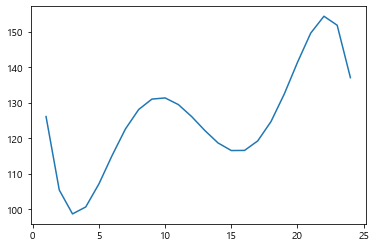

In [55]:
tmp = total[total['datetime'] == '2014-04-22T00:00:00.000000000']
yy = tmp[tmp['supplys'] == 'C']['target']
xx = list(range(1, 25))
plt.plot(xx, yy)

In [56]:
# total 데이터프레임 결측치 확인
total[total['target'] == 1.378]

,supplys,year,month,day,weekday,hour,datetime,avg_temp,mini_temp,max_temp,target


In [57]:
# total 데이터프레임 결측치 확인
total[total['target'] == 2.756]

,supplys,year,month,day,weekday,hour,datetime,avg_temp,mini_temp,max_temp,target
179198,H,2015,6,16,1,15,2015-06-16,22.6,19.2,28.5,2.756


In [58]:
total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 367920 entries, 0 to 367919
Data columns (total 11 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   supplys    367920 non-null  object        
 1   year       367920 non-null  int64         
 2   month      367920 non-null  int64         
 3   day        367920 non-null  int64         
 4   weekday    367920 non-null  int64         
 5   hour       367920 non-null  int64         
 6   datetime   367920 non-null  datetime64[ns]
 7   avg_temp   367920 non-null  float64       
 8   mini_temp  367920 non-null  float64       
 9   max_temp   367920 non-null  float64       
 10  target     367920 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(5), object(1)
memory usage: 41.7+ MB


## 위의 그래프에서 값들이 갑자기 치솟는 이상치들을 처리해주도록 하겠습니다.

In [59]:
# 일별로 이상치들을 감지하여 결측치값으로 대채해줍니다.

for supply in supplys: # 공급사별
    supply_df = total[total['supplys'] == supply]
    for year in tqdm(supply_df['year'].unique()): # 연도별
        supply_year_df = supply_df[supply_df['year'] == year]
        for month in supply_year_df['month'].unique(): # 달별
            supply_year_month_df = supply_year_df[supply_year_df['month'] == month]
            for day in supply_year_month_df['day'].unique(): # 일별
                supply_year_month_day_df = supply_year_month_df[supply_year_month_df['day'] == day]
                Q3 = supply_year_month_day_df.describe()['target'].loc['75%'] 
                Q1 = supply_year_month_day_df.describe()['target'].loc['25%']
                IQR = Q3 - Q1
                Q3_outlier = Q3 + 2*IQR  # Q3의 이상치 처리
                Q3_outlier_df = supply_year_month_day_df[supply_year_month_day_df['target'] > Q3_outlier] # 하루별 Q3_outlier 의 index를 가져옵니다.
                
                if not Q3_outlier_df.empty: # df에 Q3_outlier보다 큰값이 존재하여 빈 데이터프레임이 아닐때
                    # 전체 df total에 가져온 index의 자리를 Nan값으로 처리해줍니다.
                    total.loc[Q3_outlier_df.index, 'target'] = np.nan 

100%|██████████| 6/6 [00:53<00:00,  8.93s/it]


In [63]:
total['target'].interpolate(method='polynomial', order=3, inplace=True)

In [64]:
total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 367920 entries, 0 to 367919
Data columns (total 11 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   supplys    367920 non-null  object        
 1   year       367920 non-null  int64         
 2   month      367920 non-null  int64         
 3   day        367920 non-null  int64         
 4   weekday    367920 non-null  int64         
 5   hour       367920 non-null  int64         
 6   datetime   367920 non-null  datetime64[ns]
 7   avg_temp   367920 non-null  float64       
 8   mini_temp  367920 non-null  float64       
 9   max_temp   367920 non-null  float64       
 10  target     367920 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(5), object(1)
memory usage: 41.7+ MB


100%|██████████| 7/7 [00:23<00:00,  3.36s/it]


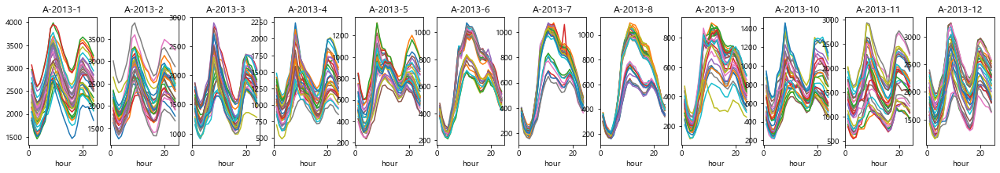

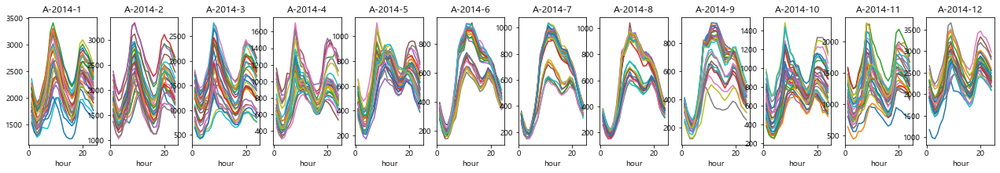

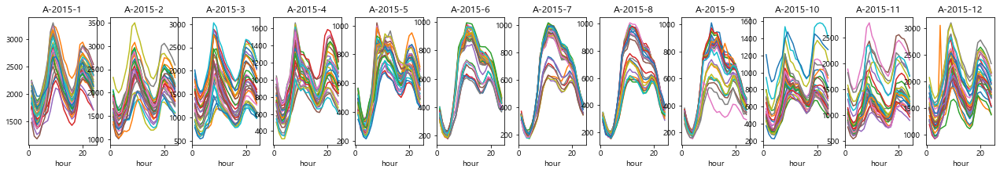

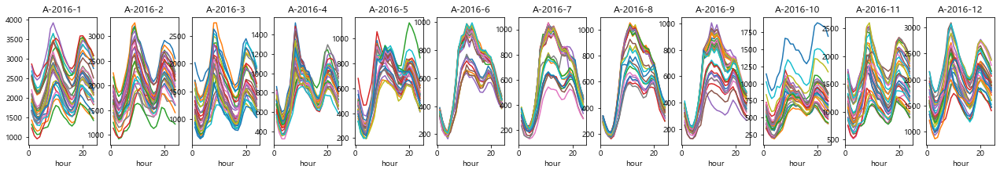

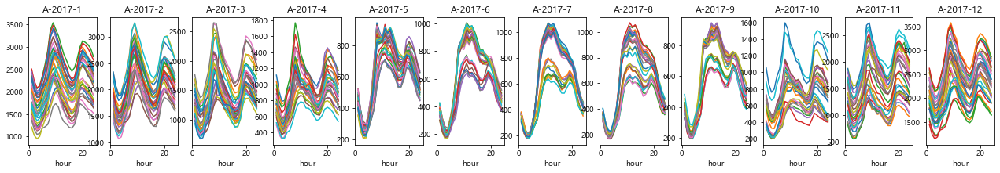

...

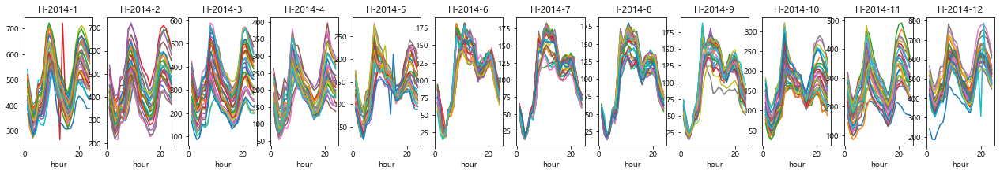

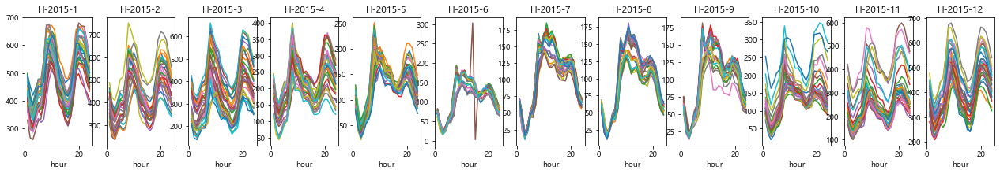

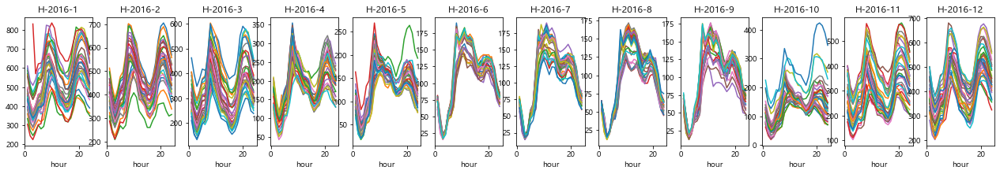

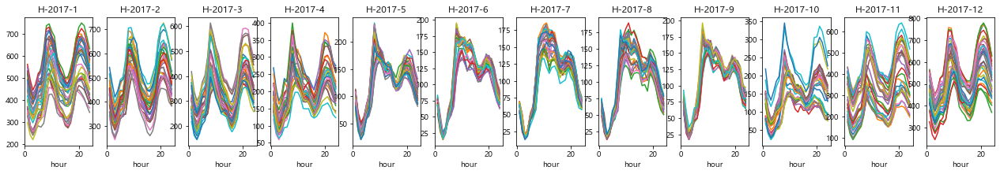

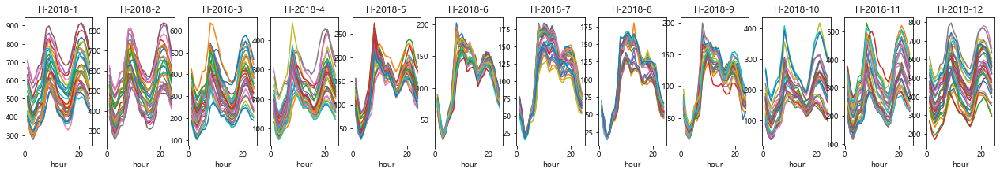

In [61]:
# 공급사-년도별-달별-각일별의 시간대 그래프 -> 이상치 잡기
years_list = [2013,2014,2015,2016,2017,2018]
month_list = [1,2,3,4,5,6,7,8,9,10,11,12]
# total['sqrt_target'] = np.sqrt(total['target'])


for supply in tqdm(supplys):
    supply_df = total[total['supplys'] == supply]
    for year in years_list:
        supply_year_df = supply_df[supply_df['year'] == year]
        plt.figure(figsize=(22,3))
        for month in month_list: 
            supply_year_month_df = supply_year_df[supply_year_df['month'] == month]
            plt.subplot(1,12,month)
            plt.title(f'{supply}-{year}-{month}')
            plt.xlabel('hour')
#             plt.ylim(0, 5500)
            
            for day in supply_year_month_df['day'].unique():
                supply_year_month_day_df = supply_year_month_df[supply_year_month_df['day'] == day]
                plt.plot(supply_year_month_day_df['hour'],supply_year_month_day_df['target'], label=f'{day}')
            

In [62]:
total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 367920 entries, 0 to 367919
Data columns (total 11 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   supplys    367920 non-null  object        
 1   year       367920 non-null  int64         
 2   month      367920 non-null  int64         
 3   day        367920 non-null  int64         
 4   weekday    367920 non-null  int64         
 5   hour       367920 non-null  int64         
 6   datetime   367920 non-null  datetime64[ns]
 7   avg_temp   367920 non-null  float64       
 8   mini_temp  367920 non-null  float64       
 9   max_temp   367920 non-null  float64       
 10  target     367854 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(5), object(1)
memory usage: 41.7+ MB


In [65]:
total.to_csv('no_outlier_lr.csv', index=False)

## LR로 만들어보기

In [32]:
C_df = total[total['supplys'] == 'C'].copy().reset_index(drop=True)
C_year = C_df['year'].unique()

In [33]:
answer_idx = C_df[C_df['target'].isna() == True].index
answer = C_df.loc[answer_idx, :]
answer

,datetime,hour,supplys,target,year,month,day,weekday
3735,2013-06-05,16,C,NaN,2013,6,5,2
6463,2013-09-27,8,C,NaN,2013,9,27,4
6559,2013-10-01,8,C,NaN,2013,10,1,1
12007,2014-05-16,8,C,NaN,2014,5,16,4
12322,2014-05-29,11,C,NaN,2014,5,29,3
18967,2015-03-02,8,C,NaN,2015,3,2,0
20383,2015-04-30,8,C,NaN,2015,4,30,3
23983,2015-09-27,8,C,NaN,2015,9,27,6
24570,2015-10-21,19,C,NaN,2015,10,21,2
24571,2015-10-21,20,C,NaN,2015,10,21,2


In [291]:
predict_list = []
for idx in range(len(answer) - 11):
    
    tmp = answer.iloc[idx, :]
    
    # 실제 예측해야 할 값
    tmp_af = tmp[['hour']].values
    year, month, day = tmp.year, tmp.month, tmp.day

    condition = (C_df['year'] != year) & (C_df['month'] == month) & (C_df['day'] == day)
    c_df = C_df.loc[condition, :].copy().dropna(axis=0)
    

    
    lin_reg = LinearRegression()
    for year in c_df['year'].unique():
        tmp_df = c_df[c_df['year'] == year]
#         print(tmp_df)
        X = tmp_df[['hour']]
        y = tmp_df[['target']]
        
        # X의 변수들을 5차함수 꼴로 변환
        poly = PolynomialFeatures(degree=0, include_bias=True)
        X_poly = poly.fit_transform(X)


        X_train, X_test, y_train, y_test = train_test_split(X_poly, y)


        lin_reg.fit(X_train, y_train)

    poly_tmp = np.array(poly.transform( np.array(tmp_af).reshape(1,-1) ))

    y_pred = lin_reg.predict(poly_tmp)
    predict_list.append(y_pred)
    
    

In [322]:
predict_list = []
for idx in range(len(answer)):
    
    tmp = answer.iloc[idx, :]
    
    # 실제 예측해야 할 값
    tmp_af = tmp[['hour']].values
    year, month, day = tmp.year, tmp.month, tmp.day

    condition = (C_df['year'] != year) & (C_df['month'] == month) & (C_df['day'] == day)
    c_df = C_df.loc[condition, :].copy().dropna(axis=0)
    

    
    lin_reg = LinearRegression()
#         print(tmp_df)
    X = c_df[['hour']]
    y = c_df[['target']]

    # X의 변수들을 5차함수 꼴로 변환
    poly = PolynomialFeatures(degree=5, include_bias=True)
    X_poly = poly.fit_transform(X)


    X_train, X_test, y_train, y_test = train_test_split(X_poly, y)


    lin_reg.fit(X_train, y_train)

    poly_tmp = np.array(poly.transform( np.array(tmp_af).reshape(1,-1) ))

    y_pred = lin_reg.predict(poly_tmp)
    predict_list.append(y_pred)
    
    

In [323]:
predict_list

[array([[94.2491396]]),
 array([[99.98445713]]),
 array([[101.28931241]]),
 array([[129.04563901]]),
 array([[98.56543614]]),
 array([[197.84749304]]),
 array([[133.8416521]]),
 array([[115.69618438]]),
 array([[106.58598769]]),
 array([[114.6437028]]),
 array([[121.00434475]]),
 array([[122.89716131]])]

In [247]:
C_df.loc[answer_idx, :]

,supplys,year,month,day,weekday,hour,datetime,avg_temp,mini_temp,max_temp,target
3735,C,2013,6,5,2,16,2013-06-05,22.3,16.4,28.9,NaN
6463,C,2013,9,27,4,8,2013-09-27,17.2,10.3,24.6,NaN
6559,C,2013,10,1,1,8,2013-10-01,20.8,16.7,26.5,NaN
12007,C,2014,5,16,4,8,2014-05-16,19.0,11.7,26.1,NaN
12322,C,2014,5,29,3,11,2014-05-29,22.8,15.5,31.1,NaN
18967,C,2015,3,2,0,8,2015-03-02,3.5,-3.0,10.5,NaN
20383,C,2015,4,30,3,8,2015-04-30,17.9,13.1,24.0,NaN
20935,C,2015,5,23,5,8,2015-05-23,20.2,14.1,27.3,NaN
23983,C,2015,9,27,6,8,2015-09-27,19.7,13.7,27.6,NaN
29695,C,2016,5,23,0,8,2016-05-23,20.6,12.5,27.8,NaN


In [136]:
answer_idx = C_df[C_df['target'].isna() == True].index
answer = C_df.loc[answer_idx, ['hour', 'avg_temp', 'mini_temp', 'mini_temp', 'max_temp']]
answer

,hour,avg_temp,mini_temp,mini_temp,max_temp
3735,16,22.3,16.4,16.4,28.9
6463,8,17.2,10.3,10.3,24.6
6559,8,20.8,16.7,16.7,26.5
12007,8,19.0,11.7,11.7,26.1
12322,11,22.8,15.5,15.5,31.1
18967,8,3.5,-3.0,-3.0,10.5
20383,8,17.9,13.1,13.1,24.0
20935,8,20.2,14.1,14.1,27.3
23983,8,19.7,13.7,13.7,27.6
29695,8,20.6,12.5,12.5,27.8


In [137]:
from sklearn.model_selection import train_test_split

In [150]:
from sklearn.preprocessing import PolynomialFeatures
poly = PolynomialFeatures(degree=5, include_bias=True)

In [151]:
condition = (C_df['year'] != 2013) & (C_df['month'] == 6) & (C_df['day'] == 5)
X = C_df.loc[condition, ['hour', 'avg_temp', 'mini_temp', 'mini_temp', 'max_temp']]
X_poly = poly.fit_transform(X)

y = C_df.loc[condition, 'target']
X_train, X_test, y_train, y_test = train_test_split(X_poly, y)
X_train.shape

(90, 252)

In [152]:
answer.iloc[0]

hour         16.0
avg_temp     22.3
mini_temp    16.4
mini_temp    16.4
max_temp     28.9
Name: 3735, dtype: float64

In [153]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)
y_pred = lin_reg.predict(X_test)

In [162]:
answer_poly = poly.transform(np.array(answer.iloc[0,:]).reshape(1,-1))
answer_poly
lin_reg.predict(answer_poly)

array([-4.7935062e+10])

In [30]:
# target을 결측치로 만든 df 확인밑 그래프가 잘 그려졌는지 확인을 위해 다시 만들어 둡니다.
isna_df = total[total['target'].isna()]
isna_df

,supplys,year,month,day,weekday,hour,datetime,avg_temp,mini_temp,max_temp,target
1616,A,2013,3,9,5,9,2013-03-09,13.5,2.3,23.7,NaN
2230,A,2013,4,3,2,23,2013-04-03,10.0,3.0,17.7,NaN
13267,B,2013,7,7,6,20,2013-07-07,24.4,22.2,27.3,NaN
13507,B,2013,7,17,2,20,2013-07-17,26.4,23.8,29.8,NaN
13531,B,2013,7,18,3,20,2013-07-18,26.4,23.2,30.8,NaN
13699,B,2013,7,25,3,20,2013-07-25,26.7,22.6,31.7,NaN
13723,B,2013,7,26,4,20,2013-07-26,27.0,22.6,32.4,NaN
13747,B,2013,7,27,5,20,2013-07-27,26.5,22.2,31.8,NaN
13771,B,2013,7,28,6,20,2013-07-28,26.0,23.6,28.9,NaN
13795,B,2013,7,29,0,20,2013-07-29,27.4,24.2,31.6,NaN


In [ ]:
total['target'].interpolate(method='polynomial', order=3, inplace=True)

-------------------

In [13]:
train_years = [2013,2014,2015,2016,2017]
val_years = [2018]

In [14]:
train = total[total['year'].isin(train_years)]
val = total[total['year'].isin(val_years)]

In [15]:
features = ['구분', 'month', 'day', 'weekday', '시간']
train_x = train[features]
train_y = train['공급량']

val_x = val[features]
val_y = val['공급량']

# 학습

In [16]:
d_train = lgb.Dataset(train_x, train_y)
d_val = lgb.Dataset(val_x, val_y)

params = {
    'objective': 'regression',
    'metric':'mae',
    'seed':42
}

model = lgb.train(params, d_train, 500, d_val, verbose_eval=20, early_stopping_rounds=10)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001457 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 84
[LightGBM] [Info] Number of data points in the train set: 306768, number of used features: 5
[LightGBM] [Info] Start training from score 934.864036
Training until validation scores don't improve for 10 rounds
[20]	valid_0's l1: 244.857
[40]	valid_0's l1: 174.855
[60]	valid_0's l1: 158.739
[80]	valid_0's l1: 153.323
[100]	valid_0's l1: 150.948
[120]	valid_0's l1: 150.463
Early stopping, best iteration is:
[112]	valid_0's l1: 150.297


# 추론 및 결과 제출

In [17]:
test = pd.read_csv('data/test.csv')
submission = pd.read_csv('data/sample_submission.csv')

In [18]:
test.head()

,일자|시간|구분
0,2019-01-01 01 A
1,2019-01-01 02 A
2,2019-01-01 03 A
3,2019-01-01 04 A
4,2019-01-01 05 A


In [19]:
submission.head()

,일자|시간|구분,공급량
0,2019-01-01 01 A,0
1,2019-01-01 02 A,0
2,2019-01-01 03 A,0
3,2019-01-01 04 A,0
4,2019-01-01 05 A,0


In [20]:
test['일자'] = test['일자|시간|구분'].str.split(' ').str[0]
test['시간'] = test['일자|시간|구분'].str.split(' ').str[1].astype(int)
test['구분'] = test['일자|시간|구분'].str.split(' ').str[2]

In [21]:
test['일자'] = pd.to_datetime(test['일자'])
test['year'] = test['일자'].dt.year
test['month'] = test['일자'].dt.month
test['day'] = test['일자'].dt.day
test['weekday'] = test['일자'].dt.weekday

In [22]:
test['구분'] = test['구분'].map(d_map)

In [23]:
test_x = test[features]

In [24]:
test_x

,구분,month,day,weekday,시간
0,0,1,1,1,1
1,0,1,1,1,2
2,0,1,1,1,3
3,0,1,1,1,4
4,0,1,1,1,5
...,...,...,...,...,...
15115,6,3,31,6,20
15116,6,3,31,6,21
15117,6,3,31,6,22
15118,6,3,31,6,23


In [25]:
preds = model.predict(test_x)

In [26]:
submission['공급량'] = preds

In [27]:
submission.to_csv('baseline.csv', index=False)